# Libraries



Import Primary Modules:

In [130]:
import random 
import numpy as np 
import pandas as pd

import matplotlib.pyplot as plt 
%matplotlib inline 

from geopy.geocoders import Nominatim

from sklearn.cluster import KMeans 
from sklearn.datasets.samples_generator import make_blobs
import folium 
import requests
import matplotlib.cm as cm
import matplotlib.colors as colors
from pandas.io.json import json_normalize 
from urllib.request import urlopen
import json
print('Libraries imported.')

Libraries imported.


# Foursquare Parameters

Setting data to use Foursquare API

In [293]:
CLIENT_ID = 'G3GR4LL0TKXIX1VVLLFCTMUONRZVR3UHNGO2U11SJXSQQ3WT' 
CLIENT_SECRET = 'KIBQJ0LETUPWK3KPZP0QSLONURSIZ33303QGJ2NN10K005WY' 
VERSION = '20180605'

LIMIT = 500 
RADIUS = 8000 

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: G3GR4LL0TKXIX1VVLLFCTMUONRZVR3UHNGO2U11SJXSQQ3WT
CLIENT_SECRET:KIBQJ0LETUPWK3KPZP0QSLONURSIZ33303QGJ2NN10K005WY


# Analysis and clean the dataset

### Load CSV

In [0]:
departamentos = pd.read_csv('/content/drive/My Drive/departamentos.csv')

In [133]:
departamentos

,categoria,centroide_lat,centroide_lon,fuente,id,nombre,nombre_completo,provincia_id,provincia_interseccion,provincia_nombre
0,Partido,-34.511876,-58.777671,ARBA - Gerencia de Servicios Catastrales,6412,José C. Paz,Partido de José C. Paz,6,0.000160,Buenos Aires
1,Departamento,-27.257551,-60.680678,Direc. Pcial. de Catastro y Cartografía,22112,O'Higgins,Departamento O'Higgins,22,0.015838,Chaco
2,Departamento,-35.631875,-64.214377,Direc. Grl. de Catastro,42147,Trenel,Departamento Trenel,42,0.013701,La Pampa
3,Partido,-37.964225,-60.249078,ARBA - Gerencia de Servicios Catastrales,6014,Adolfo Gonzales Chaves,Partido de Adolfo Gonzales Chaves,6,0.012591,Buenos Aires
4,Partido,-37.153214,-57.230787,ARBA - Gerencia de Servicios Catastrales,6315,General Juan Madariaga,Partido de General Juan Madariaga,6,0.009812,Buenos Aires
...,...,...,...,...,...,...,...,...,...,...
524,Departamento,-31.533075,-68.534286,Direc. de Geodesia y Catastro,70028,Capital,Departamento Capital,70,0.000304,San Juan
525,Departamento,-35.227243,-63.660912,Direc. Grl. de Catastro,42056,Chapaleufú,Departamento Chapaleufú,42,0.017176,La Pampa
526,Departamento,-35.679618,-63.662489,Direc. Grl. de Catastro,42105,Maracó,Departamento Maracó,42,0.017150,La Pampa
527,Departamento,-28.408395,-58.031385,IGN,18028,Concepción,Departamento Concepción,18,0.059052,Corrientes


## Get data only from Buenos Aires y CABA

In [0]:
mask1 = departamentos['provincia_nombre'] == "Buenos Aires"
mask2 = departamentos['provincia_nombre'] == "Ciudad Autónoma de Buenos Aires"

In [0]:
departamentos_bsas = departamentos[mask1 | mask2]

In [136]:
departamentos_bsas.head()

,categoria,centroide_lat,centroide_lon,fuente,id,nombre,nombre_completo,provincia_id,provincia_interseccion,provincia_nombre
0,Partido,-34.511876,-58.777671,ARBA - Gerencia de Servicios Catastrales,6412,José C. Paz,Partido de José C. Paz,6,0.000160,Buenos Aires
3,Partido,-37.964225,-60.249078,ARBA - Gerencia de Servicios Catastrales,6014,Adolfo Gonzales Chaves,Partido de Adolfo Gonzales Chaves,6,0.012591,Buenos Aires
4,Partido,-37.153214,-57.230787,ARBA - Gerencia de Servicios Catastrales,6315,General Juan Madariaga,Partido de General Juan Madariaga,6,0.009812,Buenos Aires
5,Partido,-37.335655,-59.181806,ARBA - Gerencia de Servicios Catastrales,6791,Tandil,Partido de Tandil,6,0.015972,Buenos Aires
13,Partido,-38.147744,-61.264659,ARBA - Gerencia de Servicios Catastrales,6196,Coronel Pringles,Partido de Coronel Pringles,6,0.017522,Buenos Aires


## BS AS Map



In [137]:
address = 'Buenos Aires'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Buenos Aires are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Buenos Aires are -34.6075682, -58.4370894.


In [138]:
# create map of New York using latitude and longitude values
map_bsas = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(departamentos_bsas['centroide_lat'], departamentos_bsas['centroide_lon'], departamentos_bsas['nombre_completo'], departamentos_bsas['nombre']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_bsas)  
    
map_bsas

## Studing each Neighborhood

Function to search values per Neighborhood

In [0]:
def getNearbyVenues(names, latitudes, longitudes):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
        
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, VERSION, lat, lng, RADIUS, LIMIT)
        # make the GET request
        print(url)
        results = requests.get(url).json()["response"]['groups'][0]['items']
        print(len(results))
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']

    return(nearby_venues)

In [149]:
bsas_venues = getNearbyVenues(names=departamentos_bsas['nombre'],
                                   latitudes=departamentos_bsas['centroide_lat'],
                                   longitudes=departamentos_bsas['centroide_lon'])


José C. Paz
https://api.foursquare.com/v2/venues/explore?&client_id=YI1SR5CZNUWQQ5PAP1N3J20JAPIYBHEG1H0IHEXBO35JZRMO&client_secret=MJ0VA1BTEIB1DUZB0NHX3KXD1B21RWDMXJ2UBQ2A3TNIRKKK&v=20180605&ll=-34.5118758903445,-58.7776710941743&radius=8000&limit=500
77
Adolfo Gonzales Chaves
https://api.foursquare.com/v2/venues/explore?&client_id=YI1SR5CZNUWQQ5PAP1N3J20JAPIYBHEG1H0IHEXBO35JZRMO&client_secret=MJ0VA1BTEIB1DUZB0NHX3KXD1B21RWDMXJ2UBQ2A3TNIRKKK&v=20180605&ll=-37.9642254145303,-60.249077648567706&radius=8000&limit=500
0
General Juan Madariaga
https://api.foursquare.com/v2/venues/explore?&client_id=YI1SR5CZNUWQQ5PAP1N3J20JAPIYBHEG1H0IHEXBO35JZRMO&client_secret=MJ0VA1BTEIB1DUZB0NHX3KXD1B21RWDMXJ2UBQ2A3TNIRKKK&v=20180605&ll=-37.1532136536641,-57.2307866316173&radius=8000&limit=500
1
Tandil
https://api.foursquare.com/v2/venues/explore?&client_id=YI1SR5CZNUWQQ5PAP1N3J20JAPIYBHEG1H0IHEXBO35JZRMO&client_secret=MJ0VA1BTEIB1DUZB0NHX3KXD1B21RWDMXJ2UBQ2A3TNIRKKK&v=20180605&ll=-37.3356554181577,-59.18

Save file to not use Foursquare all time

In [0]:
bsas_venues.to_csv(r'/content/drive/My Drive/L300R8000.csv', index = False)
#bsas_venues = pd.read_csv('/content/drive/My Drive/four.csv')

## Onehot encoder categories

In [151]:
bsas_venues

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,José C. Paz,-34.511876,-58.777671,Golf Club Argentino,-34.473104,-58.796576,Golf Course
1,José C. Paz,-34.511876,-58.777671,¡OH! MI TUMBES,-34.540005,-58.714972,Peruvian Restaurant
2,José C. Paz,-34.511876,-58.777671,Las Pastas de Ernesto,-34.441184,-58.777278,Italian Restaurant
3,José C. Paz,-34.511876,-58.777671,Starbucks,-34.530812,-58.701828,Coffee Shop
4,José C. Paz,-34.511876,-58.777671,El Calcio,-34.453903,-58.810905,Soccer Field
...,...,...,...,...,...,...,...
3899,Florentino Ameghino,-34.873897,-62.401353,Mundo Cine,-34.850206,-62.449567,Video Store
3900,Florentino Ameghino,-34.873897,-62.401353,hotel El Viejo Molino,-34.860050,-62.462107,Hotel
3901,Florentino Ameghino,-34.873897,-62.401353,HOTEL VIEJO MOLINO,-34.860087,-62.462286,Hotel
3902,Florentino Ameghino,-34.873897,-62.401353,"Cámara de Comercio, Producción e Industria",-34.848506,-62.466683,Camera Store


In [152]:
# one hot encoding
bsas_onehot = pd.get_dummies(bsas_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
bsas_onehot['Neighborhood'] = bsas_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [bsas_onehot.columns[-1]] + list(bsas_onehot.columns[:-1])
bsas_onehot = bsas_onehot[fixed_columns]

bsas_onehot.head(100)

,Zoo,Accessories Store,Airport,Airport Lounge,Airport Terminal,American Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Asian Restaurant,Athletics & Sports,Auto Garage,Auto Workshop,BBQ Joint,Bagel Shop,Bakery,Bar,Baseball Stadium,Basketball Stadium,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Big Box Store,Bike Trail,Bistro,Bookstore,Bowling Alley,Breakfast Spot,Brewery,Bridge,Buffet,Building,Burger Joint,Bus Station,Business Service,Butcher,Cafeteria,Café,Camera Store,...,Snack Place,Soccer Field,Soccer Stadium,Social Club,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Club,Squash Court,Stables,Stadium,Steakhouse,Supermarket,Surf Spot,Sushi Restaurant,Tapas Restaurant,Tea Room,Tennis Court,Theater,Theme Park,Theme Park Ride / Attraction,Theme Restaurant,Toll Booth,Tourist Information Center,Toy / Game Store,Track,Train Station,Travel Lounge,Tunnel,University,Vacation Rental,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
96,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
97,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
98,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## Group per Neighborhood and get Total

In [153]:
bsas_grouped = bsas_onehot.groupby('Neighborhood').mean().reset_index()
bsas_grouped

,Neighborhood,Zoo,Accessories Store,Airport,Airport Lounge,Airport Terminal,American Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Asian Restaurant,Athletics & Sports,Auto Garage,Auto Workshop,BBQ Joint,Bagel Shop,Bakery,Bar,Baseball Stadium,Basketball Stadium,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Big Box Store,Bike Trail,Bistro,Bookstore,Bowling Alley,Breakfast Spot,Brewery,Bridge,Buffet,Building,Burger Joint,Bus Station,Business Service,Butcher,Cafeteria,Café,...,Snack Place,Soccer Field,Soccer Stadium,Social Club,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Club,Squash Court,Stables,Stadium,Steakhouse,Supermarket,Surf Spot,Sushi Restaurant,Tapas Restaurant,Tea Room,Tennis Court,Theater,Theme Park,Theme Park Ride / Attraction,Theme Restaurant,Toll Booth,Tourist Information Center,Toy / Game Store,Track,Train Station,Travel Lounge,Tunnel,University,Vacation Rental,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,9 de Julio,0.0,0.00,0.0,0.0,0.5,0.000,0.500000,0.00,0.00,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.00,0.000000,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.00,0.000,0.000000,0.0,0.0,0.0,0.00,0.000000,0.0,0.00,0.000,0.000000,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.0
1,Alberti,0.0,0.00,0.0,0.0,0.0,0.000,0.000000,0.00,0.00,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.333333,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.00,0.333333,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.00,0.000,0.000000,0.0,0.0,0.0,0.00,0.000000,0.0,0.00,0.000,0.000000,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.0
2,Almirante Brown,0.0,0.00,0.0,0.0,0.0,0.000,0.032258,0.00,0.00,0.016129,0.032258,0.0,0.0,0.016129,0.0,0.048387,0.032258,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.00,0.000000,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.064516,...,0.032258,0.048387,0.016129,0.0,0.0,0.0,0.016129,0.00,0.000,0.016129,0.0,0.0,0.0,0.00,0.032258,0.0,0.00,0.000,0.016129,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.048387,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.0
3,Arrecifes,0.0,0.00,0.0,0.0,0.0,0.125,0.250000,0.00,0.00,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.125000,0.125000,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.00,0.000000,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.00,0.125,0.000000,0.0,0.0,0.0,0.00,0.000000,0.0,0.00,0.000,0.000000,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.0
4,Avellaneda,0.0,0.00,0.0,0.0,0.0,0.000,0.130000,0.02,0.01,0.000000,0.000000,0.0,0.0,0.040000,0.0,0.020000,0.020000,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.01,0.000000,0.02,0.0,0.0,0.01,0.010,0.0,0.0,0.0,0.0,0.040000,...,0.000000,0.010000,0.030000,0.0,0.0,0.0,0.000000,0.00,0.010,0.000000,0.0,0.0,0.0,0.00,0.000000,0.0,0.00,0.000,0.000000,0.01,0.02,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.00,0.0,0.01,0.0,0.0,0.0,0.00,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106,Tres Lomas,0.0,0.00,0.0,0.0,0.0,0.000,0.000000,0.00,0.00,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.00,0.000000,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.00,0.000,0.000000,0.0,0.0,0.0,0.00,0.000000,0.0,0.00,0.000,0.000000,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.00,0.0,0.00,0.0

Calculating *Total*

Set different goals

In [0]:
categorias_objetivo = [ 'Zoo',
 'Accessories Store',
 'American Restaurant',
 'Argentinian Restaurant',
 'Art Gallery',
 'Art Museum',
 'Asian Restaurant',
 'Athletics & Sports',
 'Auto Garage',
 'BBQ Joint',
 'Bagel Shop',
 'Bakery',
 'Bar',
 'Beer Bar',
 'Beer Garden',
 'Bookstore',
 'Breakfast Spot',
 'Buffet',
 'Bus Station',
 'Cafeteria',
 'Café',
 'Candy Store',
 'Casino',
 'Chinese Restaurant',
 'Chocolate Shop',
 'Church',
 'City',
 'Clothing Store',
 'Cocktail Bar',
 'College Gym',
 'Cosmetics Shop',
 'Dance Studio',
 'Deli / Bodega',
 'Department Store',
 'Dessert Shop',
 "Doctor's Office",
 'Farm',
 'Farmers Market',
 'Fast Food Restaurant',
 'Fish Market',
 'Food & Drink Shop',
 'Food Truck',
 'Fruit & Vegetable Store',
 'Furniture / Home Store',
 'Gas Station',
 'General Entertainment',
 'German Restaurant',
 'Grocery Store',
 'Gym',
 'Gym / Fitness Center',
 'Gym Pool',
 'Gymnastics Gym',
 'Harbor / Marina',
 'Hardware Store',
 'Ice Cream Shop',
 'Indian Restaurant',
 'Irish Pub',
 'Italian Restaurant',
 'Japanese Restaurant',
 'Jazz Club',
 'Korean Restaurant',
 'Latin American Restaurant',
 'Market',
 'Mediterranean Restaurant',
 "Men's Store",
 'Mexican Restaurant',
 'Mobile Phone Shop',
 'Motorcycle Shop',
 'Movie Theater',
 'Museum',
 'Nightclub',
 'Park',
 'Pet Store',
 'Pharmacy',
 'Pool',
 'Portuguese Restaurant',
 'Pub',
 'Restaurant',
 'Rock Club',
 'Theme Restaurant',
 'Toll Booth',
 'Tourist Information Center',
 'Toy / Game Store',
 'Track',
 'Train Station',
 'Travel Lounge',
 'Tunnel',
 'University',
 'Vacation Rental',
 'Vegetarian / Vegan Restaurant',
 'Video Game Store',
 'Video Store',
 'Wine Bar',
 'Wine Shop',
 "Women's Store",
 'Yoga Studio']

In [233]:
bsas_grouped['total'] = bsas_grouped[categorias_objetivo].sum(axis=1)
#sumar todo:
#bsas_grouped['total'] = bsas_grouped.sum(axis=1)
bsas_grouped['Neighborhood'] = bsas_grouped['Neighborhood'].str.upper()
bsas_grouped

,Neighborhood,Zoo,Accessories Store,Airport,Airport Lounge,Airport Terminal,American Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Asian Restaurant,Athletics & Sports,Auto Garage,Auto Workshop,BBQ Joint,Bagel Shop,Bakery,Bar,Baseball Stadium,Basketball Stadium,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Big Box Store,Bike Trail,Bistro,Bookstore,Bowling Alley,Breakfast Spot,Brewery,Bridge,Buffet,Building,Burger Joint,Bus Station,Business Service,Butcher,Cafeteria,Café,...,Soccer Field,Soccer Stadium,Social Club,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Club,Squash Court,Stables,Stadium,Steakhouse,Supermarket,Surf Spot,Sushi Restaurant,Tapas Restaurant,Tea Room,Tennis Court,Theater,Theme Park,Theme Park Ride / Attraction,Theme Restaurant,Toll Booth,Tourist Information Center,Toy / Game Store,Track,Train Station,Travel Lounge,Tunnel,University,Vacation Rental,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Wine Bar,Wine Shop,Women's Store,Yoga Studio,total
0,9 DE JULIO,0.0,0.00,0.0,0.0,0.5,0.000,0.500000,0.00,0.00,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.00,0.000000,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.00,0.000,0.000000,0.0,0.0,0.0,0.00,0.000000,0.0,0.00,0.000,0.000000,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.500000
1,ALBERTI,0.0,0.00,0.0,0.0,0.0,0.000,0.000000,0.00,0.00,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.333333,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.00,0.333333,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.00,0.000,0.000000,0.0,0.0,0.0,0.00,0.000000,0.0,0.00,0.000,0.000000,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.0,1.000000
2,ALMIRANTE BROWN,0.0,0.00,0.0,0.0,0.0,0.000,0.032258,0.00,0.00,0.016129,0.032258,0.0,0.0,0.016129,0.0,0.048387,0.032258,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.00,0.000000,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.064516,...,0.048387,0.016129,0.0,0.0,0.0,0.016129,0.00,0.000,0.016129,0.0,0.0,0.0,0.00,0.032258,0.0,0.00,0.000,0.016129,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.048387,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.645161
3,ARRECIFES,0.0,0.00,0.0,0.0,0.0,0.125,0.250000,0.00,0.00,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.125000,0.125000,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.00,0.000000,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.00,0.125,0.000000,0.0,0.0,0.0,0.00,0.000000,0.0,0.00,0.000,0.000000,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.750000
4,AVELLANEDA,0.0,0.00,0.0,0.0,0.0,0.000,0.130000,0.02,0.01,0.000000,0.000000,0.0,0.0,0.040000,0.0,0.020000,0.020000,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.01,0.000000,0.02,0.0,0.0,0.01,0.010,0.0,0.0,0.0,0.0,0.040000,...,0.010000,0.030000,0.0,0.0,0.0,0.000000,0.00,0.010,0.000000,0.0,0.0,0.0,0.00,0.000000,0.0,0.00,0.000,0.000000,0.01,0.02,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.00,0.0,0.01,0.0,0.0,0.0,0.00,0.0,0.0,0.580000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106,TRES LOMAS,0.0,0.00,0.0,0.0,0.0,0.000,0.000000,0.00,0.00,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.00,0.0,0.000,0.00,0.0,0.0,0.000,0.0,0.00,0.000000,0.00,0.0,0.0,0.00,0.000,0.0,0.0,0.0,0.0,0.000000,...,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.00,0.000,0.000000,0.0,0.0,0.0,0.00,0.000000,0.0,0.00,0.000,0.000000,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00,0

In [0]:
with urlopen('https://raw.githubusercontent.com/mgaitan/departamentos_argentina/master/departamentos-argentina.json') as response:
    dptosgeo = json.load(response)

output_dict = [x for x in dptosgeo['features'] if x['properties']['provincia'] == "BUENOS AIRES"]


bsasmap = folium.Map(location=[0, 0], zoom_start=2, tiles='Mapbox Bright')

In [0]:
dptosgeo = {'features': output_dict}

In [165]:
dptosgeo

{'features': [{'geometry': {'coordinates': [[[-58.30971908599997,
       -34.793403624999996],
      [-58.33280563400001, -34.805744171000015],
      [-58.326679230000025, -34.81371688799999],
      [-58.32252883899997, -34.81899642899998],
      [-58.30277633700001, -34.84160614000001],
      [-58.29586791999998, -34.85049438499999],
      [-58.292430878000005, -34.854873656999985],
      [-58.317165375, -34.86819458000002],
      [-58.312480927000024, -34.87479019199998],
      [-58.342182159000004, -34.89065551800002],
      [-58.346343993999994, -34.885025024000015],
      [-58.364830016999974, -34.89418792700002],
      [-58.39640045200002, -34.909923553],
      [-58.405395508000026, -34.897468566999976],
      [-58.410438537999994, -34.890586853],
      [-58.41279602100002, -34.88743591299999],
      [-58.41594314600002, -34.883014678999984],
      [-58.40876007100002, -34.87945175200002],
      [-58.41312026999998, -34.873451233000026],
      [-58.41895675699999, -34.86554336500

In [0]:
datos = []
for feature in dptosgeo['features']:
    item = {
        'Neighborhood': feature['properties']['departamento'],
    }
    datos.append(item)

In [0]:
datos = pd.DataFrame(datos)


In [0]:
datos = datos.join(bsas_grouped.set_index('Neighborhood'), on='Neighborhood')

In [0]:
datos = datos.fillna(value=0)

In [177]:
bsasmap = folium.Map(location=[-36.612415, -59.872884], zoom_start=6, tiles='Mapbox Bright')
folium.Choropleth(
    geo_data=dptosgeo,
    data=datos,
    columns=['Neighborhood', 'total'],
    key_on='feature.properties.departamento',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Total'
).add_to(bsasmap)
# folium.LayerControl().add_to(bsasmap)
bsasmap

## Lisitng top venue per Neighborhood

In [178]:
num_top_venues = 10

for hood in bsas_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = bsas_grouped[bsas_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----9 DE JULIO----
                    venue  freq
0                   total   0.5
1        Airport Terminal   0.5
2  Argentinian Restaurant   0.5
3             Pizza Place   0.0
4         Other Nightlife   0.0
5       Outdoor Sculpture   0.0
6   Outdoors & Recreation   0.0
7             Outlet Mall   0.0
8                    Park   0.0
9             Pastry Shop   0.0


----ALBERTI----
                   venue  freq
0                  total  1.00
1                    Bar  0.33
2         Breakfast Spot  0.33
3                   Park  0.33
4        Other Nightlife  0.00
5      Outdoor Sculpture  0.00
6  Outdoors & Recreation  0.00
7            Outlet Mall  0.00
8            Pastry Shop  0.00
9       Pedestrian Plaza  0.00


----ALMIRANTE BROWN----
            venue  freq
0           total  0.65
1  Ice Cream Shop  0.08
2            Café  0.06
3          Bakery  0.05
4     Pizza Place  0.05
5    Soccer Field  0.05
6   Train Station  0.05
7      Restaurant  0.03
8             Pub  0.03
9   

In [0]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [180]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = bsas_grouped['Neighborhood']

for ind in np.arange(bsas_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(bsas_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,9 DE JULIO,total,Airport Terminal,Argentinian Restaurant,Fast Food Restaurant,Garden,Furniture / Home Store,Fruit & Vegetable Store,French Restaurant,Forest,Food Truck
1,ALBERTI,total,Breakfast Spot,Park,Bar,Fish Market,Garden,Furniture / Home Store,Fruit & Vegetable Store,French Restaurant,Forest
2,ALMIRANTE BROWN,total,Ice Cream Shop,Café,Train Station,Pizza Place,Soccer Field,Bakery,Supermarket,Snack Place,Bar
3,ARRECIFES,total,Argentinian Restaurant,Sporting Goods Shop,Bakery,Hotel,Ice Cream Shop,Bar,American Restaurant,Field,Doctor's Office
4,AVELLANEDA,total,Argentinian Restaurant,Hotel,BBQ Joint,Café,Ice Cream Shop,Italian Restaurant,Pizza Place,Soccer Stadium,Clothing Store


## Cluster **Neighborhoods**

In [181]:
# set number of clusters
kclusters = 5

bsas_grouped_clustering = bsas_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(bsas_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([0, 1, 0, 1, 0, 2, 1, 1, 1, 1], dtype=int32)

Let's create a new dataframe that includes the cluster as well as the top 10 venues for each neighborhood.

In [0]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

In [0]:
neighborhoods_venues_sorted

,Cluster Labels,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,0,9 DE JULIO,total,Airport Terminal,Argentinian Restaurant,Fast Food Restaurant,Garden,Furniture / Home Store,Fruit & Vegetable Store,French Restaurant,Forest,Food Truck
1,1,ALBERTI,total,Breakfast Spot,Park,Bar,Fish Market,Garden,Furniture / Home Store,Fruit & Vegetable Store,French Restaurant,Forest
2,0,ALMIRANTE BROWN,total,Ice Cream Shop,Café,Train Station,Pizza Place,Soccer Field,Bakery,Supermarket,Snack Place,Bar
3,1,ARRECIFES,total,Argentinian Restaurant,Sporting Goods Shop,Bakery,Hotel,Ice Cream Shop,Bar,American Restaurant,Field,Doctor's Office
4,0,AVELLANEDA,total,Argentinian Restaurant,Hotel,BBQ Joint,Café,Ice Cream Shop,Italian Restaurant,Pizza Place,Soccer Stadium,Clothing Store
...,...,...,...,...,...,...,...,...,...,...,...,...
106,1,TRES LOMAS,total,Movie Theater,Gas Station,Garden,Furniture / Home Store,Fruit & Vegetable Store,French Restaurant,Forest,Food Truck,Food & Drink Shop
107,1,TRES DE FEBRERO,total,Ice Cream Shop,Café,Bakery,Argentinian Restaurant,Plaza,Coffee Shop,Restaurant,BBQ Joint,Bar
108,0,VICENTE LÓPEZ,total,Ice Cream Shop,Bakery,Pizza Place,Deli / Bodega,Park,Argentinian Restaurant,Italian Restaurant,Coffee Shop,Harbor / Marina
109,0,VILLA GESELL,total,Beach,Argentinian Restaurant,Restaurant,Pizza Place,Café,Breakfast Spot,Hotel,German Restaurant,Seafood Restaurant


In [184]:
neighborhoods_venues_sorted

,Cluster Labels,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,0,9 DE JULIO,total,Airport Terminal,Argentinian Restaurant,Fast Food Restaurant,Garden,Furniture / Home Store,Fruit & Vegetable Store,French Restaurant,Forest,Food Truck
1,1,ALBERTI,total,Breakfast Spot,Park,Bar,Fish Market,Garden,Furniture / Home Store,Fruit & Vegetable Store,French Restaurant,Forest
2,0,ALMIRANTE BROWN,total,Ice Cream Shop,Café,Train Station,Pizza Place,Soccer Field,Bakery,Supermarket,Snack Place,Bar
3,1,ARRECIFES,total,Argentinian Restaurant,Sporting Goods Shop,Bakery,Hotel,Ice Cream Shop,Bar,American Restaurant,Field,Doctor's Office
4,0,AVELLANEDA,total,Argentinian Restaurant,Hotel,BBQ Joint,Café,Ice Cream Shop,Italian Restaurant,Pizza Place,Soccer Stadium,Clothing Store
...,...,...,...,...,...,...,...,...,...,...,...,...
106,1,TRES LOMAS,total,Movie Theater,Gas Station,Garden,Furniture / Home Store,Fruit & Vegetable Store,French Restaurant,Forest,Food Truck,Food & Drink Shop
107,1,TRES DE FEBRERO,total,Ice Cream Shop,Café,Bakery,Argentinian Restaurant,Plaza,Coffee Shop,Restaurant,BBQ Joint,Bar
108,0,VICENTE LÓPEZ,total,Ice Cream Shop,Bakery,Pizza Place,Deli / Bodega,Park,Argentinian Restaurant,Italian Restaurant,Coffee Shop,Harbor / Marina
109,0,VILLA GESELL,total,Beach,Argentinian Restaurant,Restaurant,Pizza Place,Café,Breakfast Spot,Hotel,German Restaurant,Seafood Restaurant


In [185]:

bsas_merged = departamentos_bsas

bsas_merged = bsas_merged.rename(columns={"nombre": "Neighborhood"})
bsas_merged['Neighborhood'] = bsas_merged['Neighborhood'].str.upper()
bsas_merged


# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
bsas_merged = bsas_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

bsas_merged.head() # check the last columns!

,categoria,centroide_lat,centroide_lon,fuente,id,Neighborhood,nombre_completo,provincia_id,provincia_interseccion,provincia_nombre,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Partido,-34.511876,-58.777671,ARBA - Gerencia de Servicios Catastrales,6412,JOSÉ C. PAZ,Partido de José C. Paz,6,0.000160,Buenos Aires,0.0,total,Bar,Golf Course,Fast Food Restaurant,Café,Soccer Field,Coffee Shop,Argentinian Restaurant,Ice Cream Shop,Athletics & Sports
3,Partido,-37.964225,-60.249078,ARBA - Gerencia de Servicios Catastrales,6014,ADOLFO GONZALES CHAVES,Partido de Adolfo Gonzales Chaves,6,0.012591,Buenos Aires,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Partido,-37.153214,-57.230787,ARBA - Gerencia de Servicios Catastrales,6315,GENERAL JUAN MADARIAGA,Partido de General Juan Madariaga,6,0.009812,Buenos Aires,3.0,Lingerie Store,total,Fast Food Restaurant,Garden,Furniture / Home Store,Fruit & Vegetable Store,French Restaurant,Forest,Food Truck,Food & Drink Shop
5,Partido,-37.335655,-59.181806,ARBA - Gerencia de Servicios Catastrales,6791,TANDIL,Partido de Tandil,6,0.015972,Buenos Aires,0.0,total,Argentinian Restaurant,Hotel,Supermarket,Mountain,Scenic Lookout,Pizza Place,Beer Bar,Park,Fast Food Restaurant
13,Partido,-38.147744,-61.264659,ARBA - Gerencia de Servicios Catastrales,6196,CORONEL PRINGLES,Partido de Coronel Pringles,6,0.017522,Buenos Aires,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [0]:
bsas_merged = bsas_merged.dropna(axis='rows')

In [0]:
bsas_merged['Cluster Labels']= bsas_merged['Cluster Labels'].astype(int)

In [188]:
bsas_merged

,categoria,centroide_lat,centroide_lon,fuente,id,Neighborhood,nombre_completo,provincia_id,provincia_interseccion,provincia_nombre,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Partido,-34.511876,-58.777671,ARBA - Gerencia de Servicios Catastrales,6412,JOSÉ C. PAZ,Partido de José C. Paz,6,0.000160,Buenos Aires,0,total,Bar,Golf Course,Fast Food Restaurant,Café,Soccer Field,Coffee Shop,Argentinian Restaurant,Ice Cream Shop,Athletics & Sports
4,Partido,-37.153214,-57.230787,ARBA - Gerencia de Servicios Catastrales,6315,GENERAL JUAN MADARIAGA,Partido de General Juan Madariaga,6,0.009812,Buenos Aires,3,Lingerie Store,total,Fast Food Restaurant,Garden,Furniture / Home Store,Fruit & Vegetable Store,French Restaurant,Forest,Food Truck,Food & Drink Shop
5,Partido,-37.335655,-59.181806,ARBA - Gerencia de Servicios Catastrales,6791,TANDIL,Partido de Tandil,6,0.015972,Buenos Aires,0,total,Argentinian Restaurant,Hotel,Supermarket,Mountain,Scenic Lookout,Pizza Place,Beer Bar,Park,Fast Food Restaurant
14,Partido,-34.381589,-58.599454,ARBA - Gerencia de Servicios Catastrales,6805,TIGRE,Partido de Tigre,6,0.001254,Buenos Aires,0,total,Argentinian Restaurant,Restaurant,Coffee Shop,Pizza Place,Ice Cream Shop,Shopping Mall,Soccer Field,Sushi Restaurant,Hotel
37,Partido,-34.138196,-58.883022,ARBA - Gerencia de Servicios Catastrales,6126,CAMPANA,Partido de Campana,6,0.003130,Buenos Aires,1,total,Tea Room,Ice Cream Shop,Park,Restaurant,Café,Breakfast Spot,Italian Restaurant,Argentinian Restaurant,Gas Station
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
458,Comuna,-34.566228,-58.490428,Direc. de Catastro,2084,COMUNA 12,Comuna 12,2,0.076115,Ciudad Autónoma de Buenos Aires,0,total,Bakery,Ice Cream Shop,Pizza Place,Park,Plaza,Coffee Shop,Restaurant,Café,Gym / Fitness Center
464,Partido,-35.618769,-57.904320,ARBA - Gerencia de Servicios Catastrales,6217,CHASCOMÚS,Partido de Chascomús,6,0.010207,Buenos Aires,2,total,Restaurant,Hotel,Farm,Fruit & Vegetable Store,French Restaurant,Forest,Food Truck,Food & Drink Shop,Food
465,Comuna,-34.591884,-58.462774,Direc. de Catastro,2105,COMUNA 15,Comuna 15,2,0.069532,Ciudad Autónoma de Buenos Aires,0,total,Ice Cream Shop,Bakery,Coffee Shop,Pizza Place,Hotel,Café,Chocolate Shop,Plaza,Restaurant
468,Partido,-33.932191,-59.492950,ARBA - Gerencia de Servicios Catastrales,6070,BARADERO,Partido de Baradero,6,0.004832,Buenos Aires,1,total,Bar,Argentinian Restaurant,Farm,Garden,Furniture / Home Store,Fruit & Vegetable Store,French Restaurant,Forest,Food Truck


In [189]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(bsas_merged['centroide_lat'], bsas_merged['centroide_lon'], bsas_merged['Neighborhood'], bsas_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

# Analysis of a particular neighborhood

Neighborhood selected: MORON

In [0]:
moron = departamentos_bsas[departamentos_bsas['nombre'] == 'Morón']

In [0]:
centro_moron_lat = moron.centroide_lat
centro_moron_lon = moron.centroide_lon

In [0]:
with urlopen('https://raw.githubusercontent.com/mgaitan/departamentos_argentina/master/departamentos-argentina.json') as response:
    dptosgeo = json.load(response)

In [0]:
for x in dptosgeo['features'][0:100]:
  if(x['properties']['departamento'] in "MORON"):
    geo_moron = x

In [338]:
geo_moron

{'geometry': {'coordinates': [[[-58.55609512299998, -34.634700775],
    [-58.562049865999995, -34.636474609000004],
    [-58.56175231899999, -34.637245178],
    [-58.564384459999985, -34.637771606],
    [-58.566394806000005, -34.63820266699997],
    [-58.56802749600001, -34.63832855200002],
    [-58.57102584799998, -34.638317108000024],
    [-58.57020568799999, -34.64158248899997],
    [-58.58187866200001, -34.6434021],
    [-58.58070755, -34.64933013900003],
    [-58.583251953, -34.65060043300002],
    [-58.59345626800001, -34.659885406],
    [-58.59728240999999, -34.66318511999998],
    [-58.600463866999974, -34.66608810399998],
    [-58.60813522299998, -34.67311477700002],
    [-58.623439788999974, -34.68705368000002],
    [-58.639591216999975, -34.701564788999974],
    [-58.63984298700001, -34.701496124000016],
    [-58.641017913999974, -34.70446395900001],
    [-58.65598678600003, -34.69535827599998],
    [-58.65719985999999, -34.694416046000015],
    [-58.657611847, -34.694068909

In [0]:
geo_moron = {'features': [geo_moron]}

In [340]:
geo_moron

{'features': [{'geometry': {'coordinates': [[[-58.55609512299998,
       -34.634700775],
      [-58.562049865999995, -34.636474609000004],
      [-58.56175231899999, -34.637245178],
      [-58.564384459999985, -34.637771606],
      [-58.566394806000005, -34.63820266699997],
      [-58.56802749600001, -34.63832855200002],
      [-58.57102584799998, -34.638317108000024],
      [-58.57020568799999, -34.64158248899997],
      [-58.58187866200001, -34.6434021],
      [-58.58070755, -34.64933013900003],
      [-58.583251953, -34.65060043300002],
      [-58.59345626800001, -34.659885406],
      [-58.59728240999999, -34.66318511999998],
      [-58.600463866999974, -34.66608810399998],
      [-58.60813522299998, -34.67311477700002],
      [-58.623439788999974, -34.68705368000002],
      [-58.639591216999975, -34.701564788999974],
      [-58.63984298700001, -34.701496124000016],
      [-58.641017913999974, -34.70446395900001],
      [-58.65598678600003, -34.69535827599998],
      [-58.6571998599

In [341]:
moron

,categoria,centroide_lat,centroide_lon,fuente,id,nombre,nombre_completo,provincia_id,provincia_interseccion,provincia_nombre
166,Partido,-34.649141,-58.619843,ARBA - Gerencia de Servicios Catastrales,6568,Morón,Partido de Morón,6,0.000176,Buenos Aires


In [342]:
moron['nombre'] = "MORON"

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [343]:
moron

,categoria,centroide_lat,centroide_lon,fuente,id,nombre,nombre_completo,provincia_id,provincia_interseccion,provincia_nombre
166,Partido,-34.649141,-58.619843,ARBA - Gerencia de Servicios Catastrales,6568,MORON,Partido de Morón,6,0.000176,Buenos Aires


In [344]:
dptosgeo

{'features': [{'geometry': {'coordinates': [[[-58.32487869300002,
       -30.838373183999977],
      [-58.320339203, -30.838726043999998],
      [-58.31584930399998, -30.838579177999975],
      [-58.311347961000024, -30.83832931500001],
      [-58.306930541999975, -30.83895874000001],
      [-58.30253601099997, -30.839849472000026],
      [-58.298187256000006, -30.84085655199999],
      [-58.29391479499998, -30.842073441000025],
      [-58.28979873700001, -30.843627930000025],
      [-58.28535461400003, -30.844341278],
      [-58.28133010900001, -30.846097945999986],
      [-58.27799606299999, -30.84868621800001],
      [-58.27512741100003, -30.85177802999999],
      [-58.273265838999976, -30.855222701999992],
      [-58.27278900099998, -30.85909652700002],
      [-58.27243041999998, -30.863012314000002],
      [-58.27181243899997, -30.866865157999996],
      [-58.271484375, -30.870729445999984],
      [-58.27149963400001, -30.874614715999996],
      [-58.27020645099998, -30.8783130649

In [348]:
bsasmap = folium.Map(location=[34.6037,  58.3816], zoom_start=2, tiles='Mapbox Bright')
# generate choropleth map using the total immigration of each country to Canada from 1980 to 2013
folium.Choropleth(
    geo_data=dptosgeo,
    data=moron,
    columns=['nombre', 'id'],
    key_on='feature.properties.departamento',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Total'
).add_to(bsasmap)
# folium.LayerControl().add_to(bsasmap)


In [0]:
bsasmap

In [0]:
limites_moron = geo_moron['features'][0]['geometry']['coordinates'][0]

In [350]:
limites_moron

[[-58.55609512299998, -34.634700775],
 [-58.562049865999995, -34.636474609000004],
 [-58.56175231899999, -34.637245178],
 [-58.564384459999985, -34.637771606],
 [-58.566394806000005, -34.63820266699997],
 [-58.56802749600001, -34.63832855200002],
 [-58.57102584799998, -34.638317108000024],
 [-58.57020568799999, -34.64158248899997],
 [-58.58187866200001, -34.6434021],
 [-58.58070755, -34.64933013900003],
 [-58.583251953, -34.65060043300002],
 [-58.59345626800001, -34.659885406],
 [-58.59728240999999, -34.66318511999998],
 [-58.600463866999974, -34.66608810399998],
 [-58.60813522299998, -34.67311477700002],
 [-58.623439788999974, -34.68705368000002],
 [-58.639591216999975, -34.701564788999974],
 [-58.63984298700001, -34.701496124000016],
 [-58.641017913999974, -34.70446395900001],
 [-58.65598678600003, -34.69535827599998],
 [-58.65719985999999, -34.694416046000015],
 [-58.657611847, -34.69406890900001],
 [-58.66741180399998, -34.68587493899997],
 [-58.66471481299999, -34.675117493000016]

### Neighborhood Area

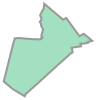

In [351]:
from shapely.geometry import Point, LineString, Polygon
polyMoron = Polygon(limites_moron)
polyMoron

In [0]:
def generate_random(number, polygon):
    list_of_points = []
    listCoor = []
    minx, miny, maxx, maxy = polygon.bounds
    counter = 0
    while counter < number:
        pnt = Point(random.uniform(minx, maxx), random.uniform(miny, maxy))
        if polygon.contains(pnt):
            list_of_points.append(pnt)
            counter += 1
    for p in list_of_points:
      listCoor.append([p.x,p.y])
    return listCoor

In [0]:
points_randums_moron = generate_random(20,polyMoron)

In [428]:
points_randums_moron

[[-58.635486910080665, -34.69703543879388],
 [-58.63030655673924, -34.69060371377394],
 [-58.63362346700854, -34.63292831464653],
 [-58.61175575367312, -34.59962415689219],
 [-58.62944318524102, -34.67706668283596],
 [-58.65362423011818, -34.64779115188456],
 [-58.59612623672567, -34.607268702854775],
 [-58.62720706663692, -34.66674749167621],
 [-58.64115501580323, -34.70082081985475],
 [-58.56787586604044, -34.63800238532337],
 [-58.61342347591603, -34.66954343422348],
 [-58.606283076174755, -34.66888177368478],
 [-58.58662137933414, -34.647614524666345],
 [-58.615896411677824, -34.626981334976314],
 [-58.58312189218811, -34.62695349987622],
 [-58.66118562398701, -34.671328778195495],
 [-58.6514624595281, -34.6338410673465],
 [-58.644436676838886, -34.64077531711296],
 [-58.61484027827654, -34.668987065070525],
 [-58.64961179244576, -34.69240635927451]]

## Studing each points

In [0]:
def getNearbyVenuesMoron(latitudes, longitudes):
    
    venues_list=[]
    for lat, lng in zip(latitudes, longitudes):
        
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, VERSION, lat, lng, RADIUS, LIMIT)
        # make the GET request
        print(url)
        results = requests.get(url).json()["response"]['groups'][0]['items']
        print(results)
        # return only relevant information for each nearby venue
        venues_list.append([(
            'Moron',
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood',
                             'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']

    return(nearby_venues)

In [0]:
columns = ['lat','long']
df_ = pd.DataFrame(columns=columns)

In [0]:
for l in points_randums_moron:
  p = {'lat':l[1],'long':l[0]}
  df_ = df_.append(p, ignore_index=True)

In [432]:
df_

,lat,long
0,-34.697035,-58.635487
1,-34.690604,-58.630307
2,-34.632928,-58.633623
3,-34.599624,-58.611756
4,-34.677067,-58.629443
5,-34.647791,-58.653624
6,-34.607269,-58.596126
7,-34.666747,-58.627207
8,-34.700821,-58.641155
9,-34.638002,-58.567876


In [433]:
LIMIT = 20
RADIUS = 1000 

bsas_venues_moron = getNearbyVenuesMoron(latitudes=df_['lat'],
                                   longitudes=df_['long'])


https://api.foursquare.com/v2/venues/explore?&client_id=G3GR4LL0TKXIX1VVLLFCTMUONRZVR3UHNGO2U11SJXSQQ3WT&client_secret=KIBQJ0LETUPWK3KPZP0QSLONURSIZ33303QGJ2NN10K005WY&v=20180605&ll=-34.69703543879388,-58.635486910080665&radius=1000&limit=20
[{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '521d5a9311d2cfafedb33c93', 'name': 'Farmacias Ahumada', 'location': {'address': 'Av. Rafael Casanova 104', 'lat': -34.69971466064453, 'lng': -58.63365936279297, 'labeledLatLngs': [{'label': 'display', 'lat': -34.69971466064453, 'lng': -58.63365936279297}, {'label': 'routing', 'lat': -34.64085240154733, 'lng': -71.36644721031189}], 'distance': 341, 'cc': 'CL', 'city': 'Santa Cruz', 'state': 'Biobío', 'country': 'Chile', 'formattedAddress': ['Av. Rafael Casanova 104', 'Santa Cruz', 'Biobío', 'Chile']}, 'categories': [{'id': '4bf58dd8d48988d10f951735', 'name': 'Pharmacy', 'pluralName': 'Pharmacies', 's

## Generating dataframe

In [0]:
bsas_venues_moron = bsas_venues_moron.reset_index()

In [435]:
bsas_venues_moron['Neighborhood Longitude'].unique()

array([-58.63548691, -58.63030656, -58.63362347, -58.61175575,
       -58.62944319, -58.65362423, -58.59612624, -58.62720707,
       -58.64115502, -58.56787587, -58.61342348, -58.60628308,
       -58.58662138, -58.61589641, -58.58312189, -58.66118562,
       -58.65146246, -58.64443668, -58.61484028, -58.64961179])

In [0]:
bsas_venues_moron['latlon'] = list(zip(bsas_venues_moron['Neighborhood Latitude'], bsas_venues_moron['Neighborhood Longitude']))

In [437]:
bsas_venues_moron

,index,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,latlon
0,0,Moron,-34.697035,-58.635487,Farmacias Ahumada,-34.699715,-58.633659,Pharmacy,"(-34.69703543879388, -58.635486910080665)"
1,1,Moron,-34.697035,-58.635487,Huellas de Plata,-34.696504,-58.631316,Cosmetics Shop,"(-34.69703543879388, -58.635486910080665)"
2,2,Moron,-34.697035,-58.635487,Las Medialunas del Abuelo,-34.697651,-58.626006,Bakery,"(-34.69703543879388, -58.635486910080665)"
3,3,Moron,-34.697035,-58.635487,Fiambreria Fercla,-34.697943,-58.625193,Deli / Bodega,"(-34.69703543879388, -58.635486910080665)"
4,4,Moron,-34.697035,-58.635487,TORTAS Y MESAS DULCES PARA EVENTOS LALE EN CAS...,-34.698448,-58.645955,Pie Shop,"(-34.69703543879388, -58.635486910080665)"
...,...,...,...,...,...,...,...,...,...
177,177,Moron,-34.692406,-58.649612,"Plaza de Barrio ""El Cortijo""",-34.696717,-58.649631,Plaza,"(-34.69240635927451, -58.64961179244576)"
178,178,Moron,-34.692406,-58.649612,FALSA ESCUADRA EVENTOS,-34.687225,-58.648610,Entertainment Service,"(-34.69240635927451, -58.64961179244576)"
179,179,Moron,-34.692406,-58.649612,"Sanitarios Alvarez = Caños y acc. p Agua, Gas ...",-34.695457,-58.657806,Accessories Store,"(-34.69240635927451, -58.64961179244576)"
180,180,Moron,-34.692406,-58.649612,Almacén de kiko,-34.685051,-58.651901,Convenience Store,"(-34.69240635927451, -58.64961179244576)"


In [441]:
# one hot encoding
bsas_moron_onehot = pd.get_dummies(bsas_venues_moron[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
bsas_moron_onehot['latlon'] = bsas_venues_moron['latlon'] 

# move neighborhood column to the first column
fixed_columns = [bsas_moron_onehot.columns[-1]] + list(bsas_moron_onehot.columns[:-1])
bsas_moron_onehot = bsas_moron_onehot[fixed_columns]

bsas_moron_onehot.head(10)

,latlon,Accessories Store,Airport Service,Argentinian Restaurant,Asian Restaurant,Athletics & Sports,BBQ Joint,Bakery,Bar,Beer Garden,Bookstore,Brewery,Bridal Shop,Burger Joint,Bus Station,Café,Chinese Restaurant,Clothing Store,Coffee Shop,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Deli / Bodega,Department Store,Electronics Store,Entertainment Service,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Food Court,Food Truck,French Restaurant,Frozen Yogurt Shop,Furniture / Home Store,Gastropub,Grocery Store,Gym,Hardware Store,Health & Beauty Service,Hockey Field,Ice Cream Shop,Indie Movie Theater,Japanese Restaurant,Market,Mexican Restaurant,Military Base,Mobile Phone Shop,Multiplex,Museum,Music Store,Nightclub,Pastry Shop,Pharmacy,Pie Shop,Pizza Place,Plaza,Print Shop,Pub,Real Estate Office,Restaurant,Sandwich Place,Shoe Store,Shopping Mall,Soccer Field,Soccer Stadium,Spanish Restaurant,Sporting Goods Shop,Supermarket,Sushi Restaurant,Tea Room,Train Station,Tunnel,Watch Shop,Women's Store
0,"(-34.69703543879388, -58.635486910080665)",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,"(-34.69703543879388, -58.635486910080665)",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,"(-34.69703543879388, -58.635486910080665)",0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,"(-34.69703543879388, -58.635486910080665)",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,"(-34.69703543879388, -58.635486910080665)",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,"(-34.69060371377394, -58.63030655673924)",0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,"(-34.69060371377394, -58.63030655673924)",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,"(-34.69060371377394, -58.63030655673924)",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,"(-34.69060371377394, -58.63030655673924)",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,"(-34.69060371377394, -58.63030655673924)",0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [442]:
bsas_moron_grouped = bsas_moron_onehot.groupby('latlon').mean().reset_index()
bsas_moron_grouped

,latlon,Accessories Store,Airport Service,Argentinian Restaurant,Asian Restaurant,Athletics & Sports,BBQ Joint,Bakery,Bar,Beer Garden,Bookstore,Brewery,Bridal Shop,Burger Joint,Bus Station,Café,Chinese Restaurant,Clothing Store,Coffee Shop,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Deli / Bodega,Department Store,Electronics Store,Entertainment Service,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Food Court,Food Truck,French Restaurant,Frozen Yogurt Shop,Furniture / Home Store,Gastropub,Grocery Store,Gym,Hardware Store,Health & Beauty Service,Hockey Field,Ice Cream Shop,Indie Movie Theater,Japanese Restaurant,Market,Mexican Restaurant,Military Base,Mobile Phone Shop,Multiplex,Museum,Music Store,Nightclub,Pastry Shop,Pharmacy,Pie Shop,Pizza Place,Plaza,Print Shop,Pub,Real Estate Office,Restaurant,Sandwich Place,Shoe Store,Shopping Mall,Soccer Field,Soccer Stadium,Spanish Restaurant,Sporting Goods Shop,Supermarket,Sushi Restaurant,Tea Room,Train Station,Tunnel,Watch Shop,Women's Store
0,"(-34.70082081985475, -58.64115501580323)",0.000000,0.0000,0.000000,0.166667,0.0000,0.000000,0.000000,0.00,0.00,0.000000,0.000,0.166667,0.000,0.0,0.000000,0.000,0.166667,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.00,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.0000,0.00,0.166667,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000,0.000,0.0,0.000000,0.166667,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.00,0.000,0.000000,0.000000,0.0000,0.0000,0.000000,0.0,0.00,0.166667
1,"(-34.69703543879388, -58.635486910080665)",0.000000,0.0000,0.000000,0.000000,0.0000,0.000000,0.200000,0.00,0.00,0.000000,0.000,0.000000,0.000,0.0,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.200000,0.0,0.200000,0.000000,0.000000,0.0,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.00,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.0000,0.00,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000,0.200,0.2,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.00,0.000,0.000000,0.000000,0.0000,0.0000,0.000000,0.0,0.00,0.000000
2,"(-34.69240635927451, -58.64961179244576)",0.200000,0.0000,0.000000,0.000000,0.0000,0.000000,0.000000,0.00,0.00,0.000000,0.000,0.000000,0.000,0.0,0.000000,0.000,0.000000,0.000000,0.00,0.200000,0.000000,0.0,0.000000,0.000000,0.000000,0.2,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.00,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.0000,0.00,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000,0.000,0.0,0.000000,0.200000,0.0,0.0,0.200000,0.000000,0.000000,0.0,0.000000,0.000000,0.00,0.000,0.000000,0.000000,0.0000,0.0000,0.000000,0.0,0.00,0.000000
3,"(-34.69060371377394, -58.63030655673924)",0.000000,0.0000,0.000000,0.000000,0.0000,0.000000,0.285714,0.00,0.00,0.000000,0.000,0.000000,0.000,0.0,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.142857,0.0,0.142857,0.000000,0.142857,0.0,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.00,0.000000,0.000,0.000000,0.142857,0.00,0.000000,0.0000,0.00,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000,0.000,0.0,0.000000,0.000000,0.0,0.0,0.142857,0.000000,0.000000,0.0,0.000000,0.000000,0.00,0.000,0.000000,0.000000,0.0000,0.0000,0.000000,0.0,0.00,0.000000
4,"(-34.67706668283596, -58.62944318524102)",0.166667,0.0000,0.000000,0.000000,0.0000,0.000000,0.000000,0.00,0.00,0.000000,0.000,0.000000,0.000,0.0,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.00,0.000000,0.000,0.000000,0.333333,0.00,0.000000,0.0000,0.00,0.000000,0.0,0.166667,0.000000,0.000000,0.166667,0.000000,0.00,0.000,0.000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.166667,0.000000,0.0,0.000000,0.000000,0.00,0.000,0.000000,0.000000,0.0000,0.0000,0.000000,0.0,0.00,0.000000
5,"(-34.671328778195495, -58.66118562398701)"

In [445]:
bsas_moron_grouped.columns

Index(['latlon', 'Accessories Store', 'Airport Service',
       'Argentinian Restaurant', 'Asian Restaurant', 'Athletics & Sports',
       'BBQ Joint', 'Bakery', 'Bar', 'Beer Garden', 'Bookstore', 'Brewery',
       'Bridal Shop', 'Burger Joint', 'Bus Station', 'Café',
       'Chinese Restaurant', 'Clothing Store', 'Coffee Shop', 'Concert Hall',
       'Convenience Store', 'Cosmetics Shop', 'Creperie', 'Deli / Bodega',
       'Department Store', 'Electronics Store', 'Entertainment Service',
       'Falafel Restaurant', 'Farmers Market', 'Fast Food Restaurant',
       'Food Court', 'Food Truck', 'French Restaurant', 'Frozen Yogurt Shop',
       'Furniture / Home Store', 'Gastropub', 'Grocery Store', 'Gym',
       'Hardware Store', 'Health & Beauty Service', 'Hockey Field',
       'Ice Cream Shop', 'Indie Movie Theater', 'Japanese Restaurant',
       'Market', 'Mexican Restaurant', 'Military Base', 'Mobile Phone Shop',
       'Multiplex', 'Museum', 'Music Store', 'Nightclub', 'Pastry Shop

In [0]:
categorias_objetivo=['Accessories Store',
       'Argentinian Restaurant',  'Athletics & Sports',
        'Bakery', 'Bar', 'Beer Garden', 'Bookstore', 'Brewery',
        'Burger Joint', 'Bus Station', 'Café',
       'Convenience Store', 'Cosmetics Shop', 'Creperie', 'Deli / Bodega','Grocery Store', 'Gym',
       'Ice Cream Shop', 'Indie Movie Theater', 'Japanese Restaurant',
       'Market', 'Mexican Restaurant', 'Military Base', 'Mobile Phone Shop','Music Store',
       'Pharmacy', 'Pizza Place', 'Plaza', 'Pub',
       'Restaurant', 'Sandwich Place', 'Shoe Store',
       'Shopping Mall', 'Soccer Field', 
       'Supermarket', 'Sushi Restaurant', 'Tea Room',
       'Train Station']

In [458]:
bsas_moron_grouped['total'] = bsas_moron_grouped[categorias_objetivo].sum(axis=1)
bsas_moron_grouped['total'].unique()

array([0.33333333, 0.8       , 0.6       , 0.57142857, 0.5       ,
       0.875     , 0.77777778, 0.75      , 0.        , 0.9       ,
       0.94117647, 0.75      , 0.42105263, 0.4       ])

In [0]:
bsas_moron_grouped[['lat','long']] = bsas_moron_grouped['latlon'].apply(pd.Series)

In [460]:
bsas_moron_grouped

,latlon,Accessories Store,Airport Service,Argentinian Restaurant,Asian Restaurant,Athletics & Sports,BBQ Joint,Bakery,Bar,Beer Garden,Bookstore,Brewery,Bridal Shop,Burger Joint,Bus Station,Café,Chinese Restaurant,Clothing Store,Coffee Shop,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Deli / Bodega,Department Store,Electronics Store,Entertainment Service,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Food Court,Food Truck,French Restaurant,Frozen Yogurt Shop,Furniture / Home Store,Gastropub,Grocery Store,Gym,Hardware Store,Health & Beauty Service,Hockey Field,Ice Cream Shop,Indie Movie Theater,Japanese Restaurant,Market,Mexican Restaurant,Military Base,Mobile Phone Shop,Multiplex,Museum,Music Store,Nightclub,Pastry Shop,Pharmacy,Pie Shop,Pizza Place,Plaza,Print Shop,Pub,Real Estate Office,Restaurant,Sandwich Place,Shoe Store,Shopping Mall,Soccer Field,Soccer Stadium,Spanish Restaurant,Sporting Goods Shop,Supermarket,Sushi Restaurant,Tea Room,Train Station,Tunnel,Watch Shop,Women's Store,total,lat,long
0,"(-34.70082081985475, -58.64115501580323)",0.000000,0.0000,0.000000,0.166667,0.0000,0.000000,0.000000,0.00,0.00,0.000000,0.000,0.166667,0.000,0.0,0.000000,0.000,0.166667,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.00,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.0000,0.00,0.166667,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000,0.000,0.0,0.000000,0.166667,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.00,0.000,0.000000,0.000000,0.0000,0.0000,0.000000,0.0,0.00,0.166667,0.333333,-34.700821,-58.641155
1,"(-34.69703543879388, -58.635486910080665)",0.000000,0.0000,0.000000,0.000000,0.0000,0.000000,0.200000,0.00,0.00,0.000000,0.000,0.000000,0.000,0.0,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.200000,0.0,0.200000,0.000000,0.000000,0.0,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.00,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.0000,0.00,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000,0.200,0.2,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.00,0.000,0.000000,0.000000,0.0000,0.0000,0.000000,0.0,0.00,0.000000,0.800000,-34.697035,-58.635487
2,"(-34.69240635927451, -58.64961179244576)",0.200000,0.0000,0.000000,0.000000,0.0000,0.000000,0.000000,0.00,0.00,0.000000,0.000,0.000000,0.000,0.0,0.000000,0.000,0.000000,0.000000,0.00,0.200000,0.000000,0.0,0.000000,0.000000,0.000000,0.2,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.00,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.0000,0.00,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000,0.000,0.0,0.000000,0.200000,0.0,0.0,0.200000,0.000000,0.000000,0.0,0.000000,0.000000,0.00,0.000,0.000000,0.000000,0.0000,0.0000,0.000000,0.0,0.00,0.000000,0.600000,-34.692406,-58.649612
3,"(-34.69060371377394, -58.63030655673924)",0.000000,0.0000,0.000000,0.000000,0.0000,0.000000,0.285714,0.00,0.00,0.000000,0.000,0.000000,0.000,0.0,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.142857,0.0,0.142857,0.000000,0.142857,0.0,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.00,0.000000,0.000,0.000000,0.142857,0.00,0.000000,0.0000,0.00,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.000,0.000,0.0,0.000000,0.000000,0.0,0.0,0.142857,0.000000,0.000000,0.0,0.000000,0.000000,0.00,0.000,0.000000,0.000000,0.0000,0.0000,0.000000,0.0,0.00,0.000000,0.571429,-34.690604,-58.630307
4,"(-34.67706668283596, -58.62944318524102)",0.166667,0.0000,0.000000,0.000000,0.0000,0.000000,0.000000,0.00,0.00,0.000000,0.000,0.000000,0.000,0.0,0.000000,0.000,0.000000,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000,0.00,0.000000,0.000,0.000000,0.333333,0.00,0.000000,0.0000,0.00,0.000000,0.0,0.166667,0.000000,0.000000,0.166667,0.000000,0.00,0.000,0.000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.166667,0.00000

In [461]:
print(centro_moron_lat)
print(centro_moron_lon)

166   -34.649141
Name: centroide_lat, dtype: float64
166   -58.619843
Name: centroide_lon, dtype: float64


In [0]:
latitude = -34.700821	
longitude = -58.641155
moron_map = folium.Map(location=[latitude, longitude], zoom_start=12)


## Plotting map

In [474]:
# instantiate a feature group for the incidents in the dataframe
incidents = folium.map.FeatureGroup()

# loop through the 100 crimes and add each to the incidents feature group
for lat, lng, radius in zip(bsas_moron_grouped.lat, bsas_moron_grouped.long, moron_join.total):
    incidents.add_child(
        folium.CircleMarker(
            [lat, lng],
            radius=radius*100, # define how big you want the circle markers to be
            color='yellow',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6
        )
    )

# add incidents to map
moron_map.add_child(incidents)